In [1]:
# House Price Prediction with Clustering and Filtering

# Import Required Libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [2]:
# Data Loading
# Load the dataset. Replace the file path with your actual file path.
file_path = 'preprocessed.json'
df = pd.read_json(file_path)
df.head()

,ID,Title,Price,UpdatedAt,Type,Region,Author,AuthorProfile,Description,HousingType,TotalArea,Condition,NrRooms,Balcony,Floor,NumberOfFloors,Lon,Lat
0,82269463,"Apartament cu 2 camere, 80 m², Botanica, Chișinău",99900,2023-04-30T19:05:00Z,Tipul: Vând,"Moldova, Chișinău mun., Chișinău, Botanica,...","topestate-botanica 2,8",https://999.md/ro/profile/topestate-botanica,,Construcţii noi,80,Euroreparație,2,1,16,17,28.843789,46.986127
1,78509490,"Apartament cu 3 camere, 99 m², Centru, Chișinău",159900,2023-04-30T13:27:00Z,Tipul: Vând,"Moldova, Chișinău mun., Chișinău, Centru, ...",Connect6565,https://999.md/ro/profile/Connect6565,,Construcţii noi,99,Euroreparație,3,1,7,8,28.850124,47.020729
2,80854492,"O cameră, 17 m², Botanica, Chișinău",7900,2023-05-01T11:00:00Z,Tipul: Vând,"Moldova, Chișinău mun., Chișinău, Botanica,...",MAX-202,https://999.md/ro/profile/MAX-202,,Secundar,17,Reparație cosmetică,0,1,5,5,28.949794,46.936900
3,82058441,"Apartament cu 3 camere, 84 m², Durlești, Chișinău",65000,2023-05-01T11:15:00Z,Tipul: Vând,"Moldova, Chișinău mun., Chișinău, Durlești,...",acces219,https://999.md/ro/profile/acces219,,Construcţii noi,84,La alb,3,1,7,8,28.760488,47.011068
4,81788666,"Apartament cu 2 camere, 67 m², Ciocana, Chișinău",72999,2023-04-27T10:26:00Z,Tipul: Vând,"Moldova, Chișinău mun., Chișinău, Ciocana, ...",Lumeamd-Evelina,https://999.md/ro/profile/Lumeamd-Evelina,,Construcţii noi,67,Euroreparație,2,2,2,9,28.894026,47.037872


In [3]:
# Data Cleaning
# Convert 'UpdatedAt' to datetime format
df['UpdatedAt'] = pd.to_datetime(df['UpdatedAt'])

# Feature Engineering
# Extract month and year from 'UpdatedAt'
df['UpdateMonth'] = df['UpdatedAt'].dt.month
df['UpdateYear'] = df['UpdatedAt'].dt.year

In [4]:
# Apply Filtering Conditions
# Limit the price between 25000 and 200000 and remove properties with 0 rooms
filtered_df = df[(df['Price'] >= 25000) & (df['Price'] <= 200000) & (df['NrRooms'] > 0)]


In [5]:
# Standardize the features for clustering
clustering_features_geo = ['Lat', 'Lon']
scaler_geo = StandardScaler()
scaled_data_geo = scaler_geo.fit_transform(filtered_df[clustering_features_geo])


In [6]:
# Perform KMeans clustering based on 'Lat' and 'Lon'
kmeans_geo = KMeans(n_clusters=25, random_state=42)
filtered_df['GeoCluster'] = kmeans_geo.fit_predict(scaled_data_geo)

/home/stefan/PycharmProjects/sad/venv/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_6451/3294672009.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['GeoCluster'] = kmeans_geo.fit_predict(scaled_data_geo)


In [7]:
# Extended Exploratory Data Analysis (EDA)
# Summary statistics
print(filtered_df.describe())

               Price     TotalArea       NrRooms       Balcony         Floor  \
count   28724.000000  28724.000000  28724.000000  28724.000000  28724.000000   
mean    76498.478694     66.807722      2.080003      1.172782      5.363181   
std     34672.591783     63.098245      0.811739      0.597185      3.599039   
min     25000.000000      1.000000      1.000000      0.000000      0.000000   
25%     50900.000000     49.000000      2.000000      1.000000      3.000000   
50%     68900.000000     64.000000      2.000000      1.000000      5.000000   
75%     94900.000000     77.000000      3.000000      1.000000      8.000000   
max    200000.000000   6485.000000      5.000000      3.000000     25.000000   

       NumberOfFloors           Lon           Lat   UpdateMonth    UpdateYear  \
count    28724.000000  28724.000000  28724.000000  28724.000000  28724.000000   
mean         9.446317     28.804427     47.048064      3.978868   2023.429258   
std          3.877041      0.193289 

In [8]:
# Correlation matrix
corr_matrix = filtered_df.corr(numeric_only=True)
print(corr_matrix)

                   Price  TotalArea   NrRooms   Balcony     Floor  \
Price           1.000000   0.248094  0.398812  0.071063  0.149607   
TotalArea       0.248094   1.000000  0.266026  0.071232  0.018586   
NrRooms         0.398812   0.266026  1.000000  0.220196 -0.033649   
Balcony         0.071063   0.071232  0.220196  1.000000  0.034074   
Floor           0.149607   0.018586 -0.033649  0.034074  1.000000   
NumberOfFloors  0.237430   0.027512 -0.094282  0.026148  0.580768   
Lon             0.148269   0.003152 -0.088014 -0.035274  0.090999   
Lat            -0.107840  -0.003892  0.070667  0.046192 -0.039210   
UpdateMonth    -0.019654   0.009537  0.014742 -0.000014 -0.006068   
UpdateYear      0.210397  -0.003721 -0.053154 -0.041389  0.043542   
GeoCluster     -0.025370  -0.020194 -0.031398 -0.051417 -0.047802   

                NumberOfFloors       Lon       Lat  UpdateMonth  UpdateYear  \
Price                 0.237430  0.148269 -0.107840    -0.019654    0.210397   
TotalArea    

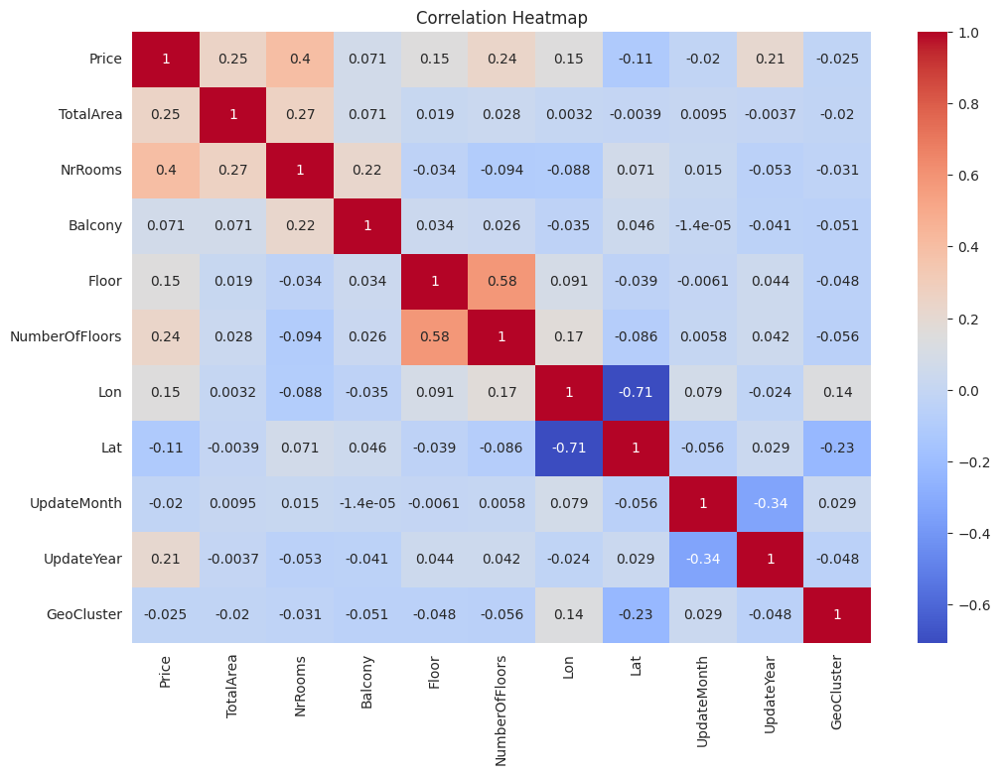

In [9]:
# Heatmap for correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()


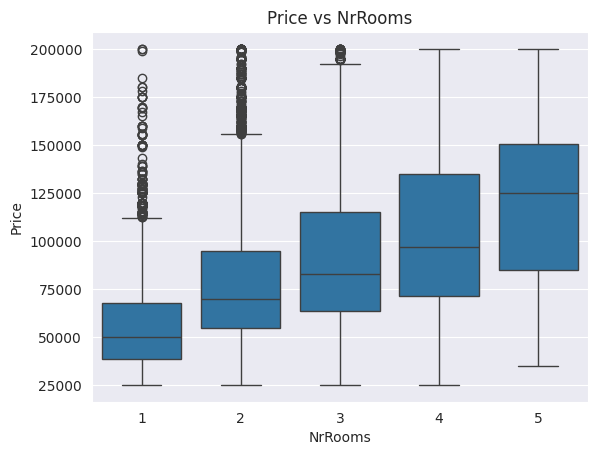

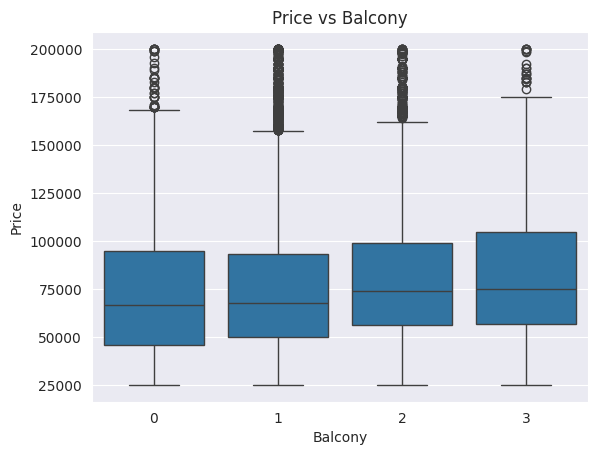

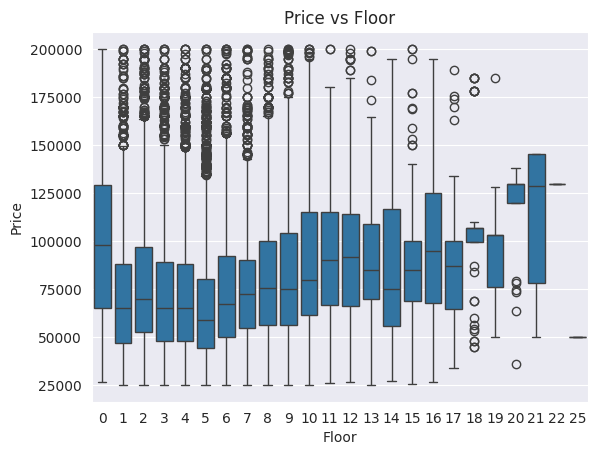

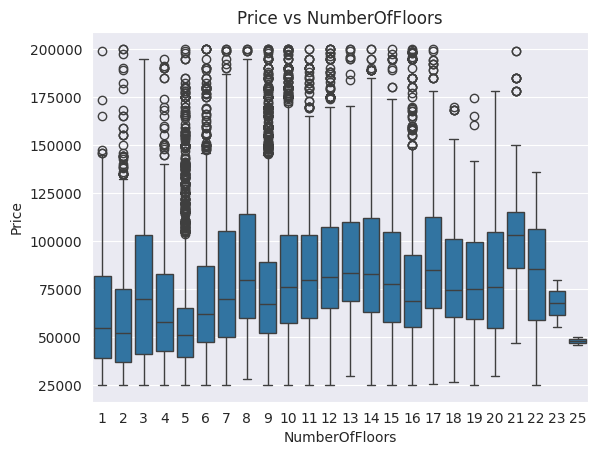

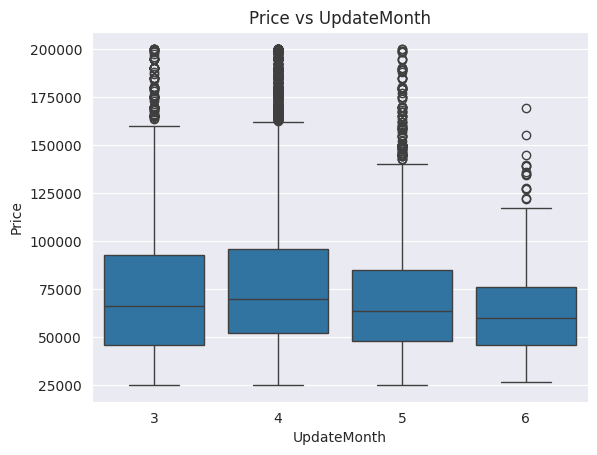

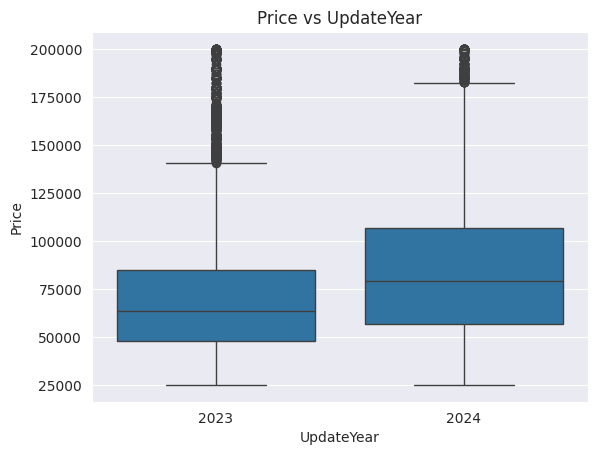

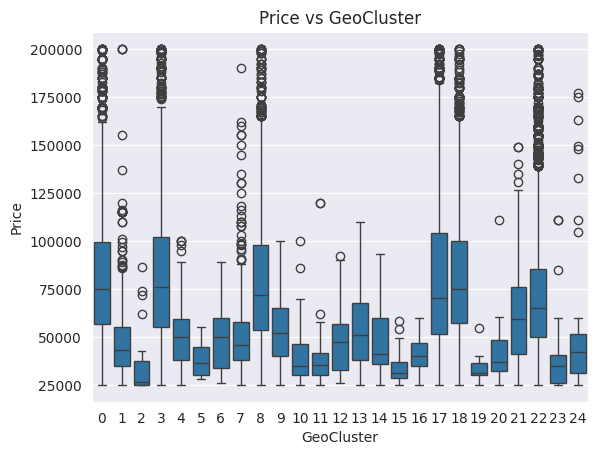

In [10]:
# Boxplots for categorical features
for feature in ['NrRooms', 'Balcony', 'Floor', 'NumberOfFloors', 'UpdateMonth', 'UpdateYear', 'GeoCluster']:
    sns.boxplot(x=feature, y='Price', data=filtered_df)
    plt.title(f'Price vs {feature}')
    plt.show()


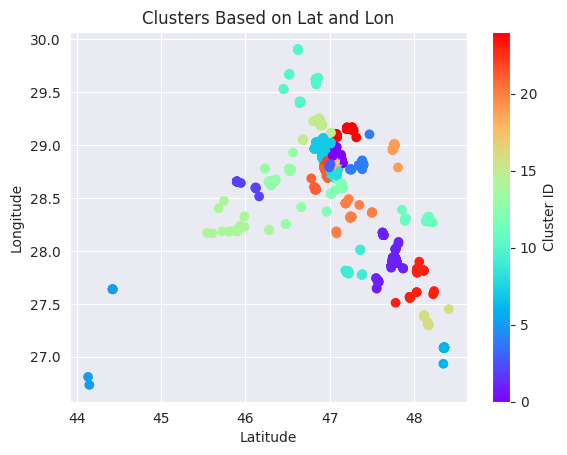

In [11]:



# Visualizing the Clusters on a Scatter Plot
plt.scatter(filtered_df['Lat'], filtered_df['Lon'], c=filtered_df['GeoCluster'], cmap='rainbow')
plt.title('Clusters Based on Lat and Lon')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.colorbar().set_label('Cluster ID')
plt.show()

In [12]:
from folium import plugins, folium
from branca.utilities import split_six
import geopandas as geopandas

geometry = geopandas.points_from_xy(df.Lat, df.Lon)
geo_df = geopandas.GeoDataFrame(
    df[["Title", "Price", "Lon", "Lat"]], geometry=geometry
)

geo_df.head()
map = folium.Map(location=[filtered_df['Lat'].mean(), filtered_df['Lon'].mean()], tiles="OpenStreetMap", zoom_start=7)

heat_data = [[point.xy[0][0], point.xy[1][0]] for point in geo_df.geometry]
print(heat_data[0])
plugins.HeatMap(heat_data, radius=12).add_to(map)
map


[46.986127, 28.8437895]


In [13]:
import folium

# Create a colormap
cmap = plt.get_cmap('tab20', 20)

# Create a map object
m = folium.Map(location=[filtered_df['Lat'].mean(), filtered_df['Lon'].mean()], zoom_start=13)

# Add points to the map
for idx, row in filtered_df.iterrows():
    color = plt.cm.tab20(row['GeoCluster'] % 20)  # Cycle through 20 colors
    color = [int(x*255) for x in color[:3]]  # Convert to 0-255 RGB scale
    color = f'#{color[0]:02x}{color[1]:02x}{color[2]:02x}'  # Convert to hexadecimal

    folium.CircleMarker(location=[row['Lat'], row['Lon']],
                        radius=5,
                        color=color,
                        fill=True,
                        fill_opacity=0.7).add_to(m)


# Show the map
m

In [14]:
features = ['TotalArea', 'NrRooms', 'Balcony', 'Floor', 'NumberOfFloors','Lat', 'Lon',  'UpdateMonth',  'GeoCluster','Price']

filtered_df[features].to_csv('sample.csv', index=False)

In [15]:
# Model Building
# Train a Random Forest model
target = 'Price'
X_train, X_test, y_train, y_test = train_test_split(filtered_df[features], filtered_df[target], test_size=0.2, random_state=42)
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor.fit(X_train, y_train)


RandomForestRegressor(random_state=42)

In [16]:
# Evaluation
# Evaluate the model
y_pred = rf_regressor.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
rmse = mse ** 0.5
r2 = r2_score(y_test, y_pred)
print(f'MSE: {mse}, RMSE: {rmse}, R2: {r2}')

MSE: 431.53142290688135, RMSE: 20.773334419560125, R2: 0.9999996425918484


In [17]:
# # Hyperparameter Tuning
# # Grid search for hyperparameter tuning
# param_grid = {
#     'n_estimators': [50, 100],
#     'max_features': ['auto', 'sqrt'],
#     'max_depth': [5, None],
#     'min_samples_split': [2, 5],
#     'min_samples_leaf': [1, 2]
# }
# grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)
# grid_search.fit(X_train, y_train)
# best_params = grid_search.best_params_
# best_rf = RandomForestRegressor(**best_params, random_state=42)
# best_rf.fit(X_train, y_train)
# y_pred_best = best_rf.predict(X_test)
# r2_best = r2_score(y_test, y_pred_best)
# print(f'Best Params: {best_params}, Best R2: {r2_best}')

Fitting 3 folds for each of 32 candidates, totalling 96 fits


KeyboardInterrupt: 